In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import scanpy.external as sce
from matplotlib.pyplot import rc_context

sc.settings.verbosity = 4  # show logging output
# sc.settings.autosave = True  # save figures, do not show them
sc.settings.set_figure_params(dpi=400, dpi_save=500)  # set sufficiently high resolution for saving
sc.settings.figdir = '/directflow/SCCGGroupShare/projects/blabow/tenk10k_phase1/data_processing/scanpy/output/integrated_objects/figures'

In [2]:
adata = sc.read('/directflow/SCCGGroupShare/projects/blabow/tenk10k_phase1/data_processing/scanpy/output/integrated_objects/240_libraries/240_libraries_concatenated_harmony_leiden_filtered_reanalysed.h5ad')

## Plot the Ambient RNA

In [3]:
adata.obs.columns
# which metrics do we get from cellbender?

Index(['cellbender_background_fraction', 'cellbender_cell_probability',
       'cellbender_cell_size', 'cellbender_droplet_efficiency',
       'celltypist_predicted_labels', 'celltypist_over_clustering',
       'celltypist_majority_voting', 'celltypist_conf_score', 'wg2_sample',
       'wg2_nCount_RNA', 'wg2_nFeature_RNA', 'wg2_percent_mt',
       'wg2_azimuth_predicted_celltype_l2',
       'wg2_azimuth_predicted_celltype_l2_score', 'wg2_scpred_prediction',
       'Vireo_Individual_Assignment', 'Vireo_DropletType',
       'scDblFinder_DropletType', 'scDblFinder_Score', 'scds_score',
       'scds_DropletType', 'MajoritySinglet_DropletType',
       'MajoritySinglet_Individual_Assignment', 'n_genes', 'n_genes_by_counts',
       'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo',
       'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb',
       'original_barcode', 'new_cell_name', 'sequencing_library', 'individual',
       'cohort', 'onek1k_id', 'cpg_id_old', 'tob_i

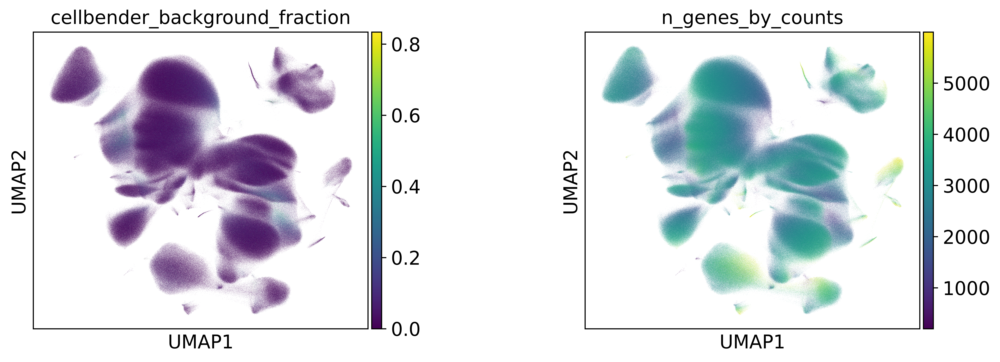

In [5]:
sc.pl.umap(
    adata,
    color=["cellbender_background_fraction", "n_genes_by_counts"],
    sort_order=True,
    wspace=0.5,
    ncols=2,
)

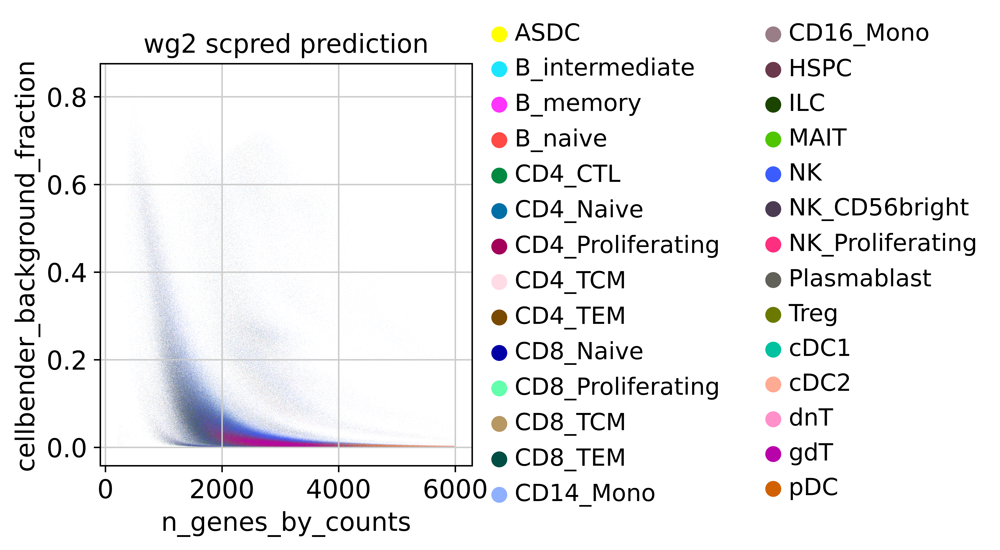

In [18]:
sc.pl.scatter(
    adata,
    x="n_genes_by_counts",
    y="cellbender_background_fraction",
    color="wg2_scpred_prediction",
    sort_order=True,
)

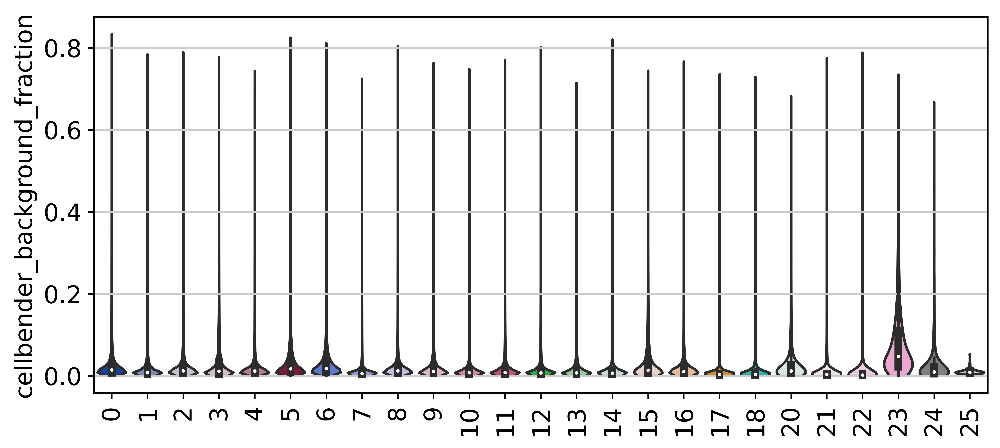

In [9]:
with rc_context({"figure.figsize": (8, 4)}):
    sc.pl.violin(
        adata,  
        ["cellbender_background_fraction"],
        groupby="leiden",
        stripplot=False,  # remove the internal dots
        inner="box",  # adds a boxplot inside violins
        rotation=90,
    )

## Plot the cell complexity scores 

In [ ]:
## Add log10 number of genes per UMI for each cell to metadata
# this is another measure of cell complexity 
# merged_seurat$log10GenesPerUMI <- log10(merged_seurat$nFeature_RNA) / log10(merged_seurat$nCount_RNA)
adata.obs['log10GenesPerUMI'] = np.log10(adata.obs['n_genes_by_counts']) / np.log10(adata.obs['total_counts'])